In [1]:
%tensorflow_version 2.x
import tensorflow as tf
import imageio
import datetime
import os
import glob
import time
import matplotlib.pyplot as plt
from IPython import display
import imageio

In [2]:
dataset_url = "https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz"
path_to_zip = tf.keras.utils.get_file('facades.tar.gz',
                                      origin=dataset_url,
                                      extract=True)
PATH = os.path.join(os.path.dirname(path_to_zip), 'facades/')

30171136/30168306 [==============================] - 8s 0us/step


In [3]:
buffer_size = 400
batch_size = 1
img_width = 256
img_height = 256
channels = 3
img_shape = (img_width, img_height, 3)

In [9]:
def load(file):
    img = tf.io.read_file(file)
    img = tf.image.decode_jpeg(img)

    w = tf.shape(img)[1]
    w = w // 2

    real_image = img[:, :w, :]
    input_image = img[:, w:, :]

    real_image = tf.cast(real_image, tf.float32)
    input_image = tf.cast(input_image, tf.float32)

    return input_image, real_image

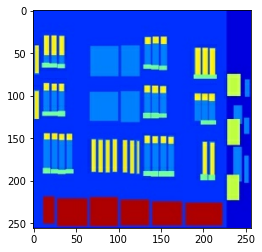

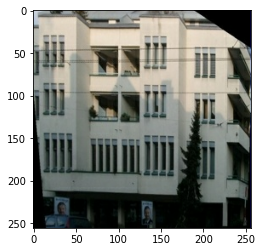

In [11]:
input, target = load(PATH + 'train/1.jpg')
plt.figure()
plt.imshow(input / 255.0)
plt.figure()
plt.imshow(target / 255.0)

In [12]:
def resize(input_image, real_image, width, height):
    input_image = tf.image.resize(input_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return input_image, real_image

In [18]:
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis = 0)
    cropped_image = tf.image.random_crop(stacked_image,
                                          size=[2, img_height, img_width, 3 ])
    
    return cropped_image[0], cropped_image[1]

In [14]:
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1
    return input_image, real_image

In [20]:
@tf.function()
def random_jitter(input_image, real_image):
    input_image, real_image = resize(input_image, real_image, 286, 286)
    
    input_image, real_image = random_crop(input_image, real_image)
    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)

    return input_image, real_image

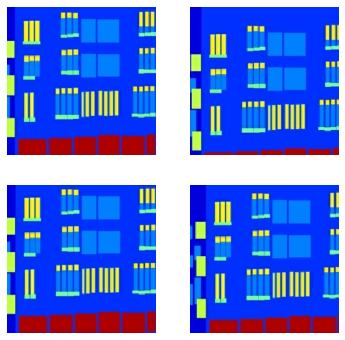

In [21]:
plt.figure(figsize = (6, 6))
for i in range(4):
    rj_input, rj_real = random_jitter(input, target)
    plt.subplot(2, 2, i + 1)
    plt.imshow(rj_input / 255.0)
    plt.axis('off')
plt.show()

In [26]:
def load_image_train(file):
    input_image, real_image = load(file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [23]:
def load_image_test(file):
    input_image, real_image = load(file)
    input_image, real_image = resize(input_image, real_image, img_width, img_height)
    input_image, real_image = normalize(input_image, real_image)
    
    return input_image, real_image

In [27]:
train_dataset = tf.data.Dataset.list_files(PATH + "train/*.jpg")
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls = tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(buffer_size)
train_dataset = train_dataset.batch(batch_size)

test_dataset = tf.data.Dataset.list_files(PATH + 'test/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(batch_size)

In [31]:
train_dataset.element_spec, test_dataset.element_spec

((TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 256, 256, None), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 256, 256, None), dtype=tf.float32, name=None)))

In [41]:
def encoder_block(input, kernel, batchnorm=True):
    init = tf.random_normal_initializer(0., 0.02)
    with tf.name_scope("Convolutional Encoder"):
        x = tf.keras.layers.Conv2D(kernel, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(input)
        if batchnorm:
            x = tf.keras.layers.BatchNormalization()(x, training=True)
        x = tf.keras.layers.LeakyReLU(alpha=0.2)(x)
    return x

def decoder_block(input, skip_con, kernel, dropout=True):
    init = tf.random_normal_initializer(0., 0.02)
    with tf.name_scope("DeConvolutional Decoder"):
        x = tf.keras.layers.Conv2DTranspose(kernel, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(input)
        x = tf.keras.layers.BatchNormalization()(x, training=True)
        if dropout:
            x = tf.keras.layers.Dropout(0.5)(x, training=True)
        x = tf.keras.layers.Concatenate()([x, skip_con])
        x = tf.keras.layers.Activation("relu")(x)
    return x

In [42]:
def create_generator(image_shape=(256, 256, 3)):
    init = tf.random_normal_initializer(0., 0.02)
    input_image = tf.keras.layers.Input(shape=image_shape)

    with tf.name_scope("Generator"):
        # Encoder of the U-Net Architecture
        with tf.name_scope("Encoder"):
            enc_1 = encoder_block(input_image, 64, batchnorm=False)
            enc_2 = encoder_block(enc_1, 128)
            enc_3 = encoder_block(enc_2, 256)
            enc_4 = encoder_block(enc_3, 512)
            enc_5 = encoder_block(enc_4, 512)
            enc_6 = encoder_block(enc_5, 512)
            enc_7 = encoder_block(enc_6, 512)

        # BottleNeck of the U-Net Architecture
        with tf.name_scope("Latent Space"):
            latent_space = tf.keras.layers.Conv2D(512, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(enc_7)
            latent_space = tf.keras.layers.Activation("relu")(latent_space)

        # Decoder of the U-Net Architecture
        with tf.name_scope("Decoder"):
            denc_1 = decoder_block(latent_space, enc_7, 512)
            denc_2 = decoder_block(denc_1, enc_6, 512)
            denc_3 = decoder_block(denc_2, enc_5, 512)
            denc_4 = decoder_block(denc_3, enc_4, 512, dropout = False)
            denc_5 = decoder_block(denc_4, enc_3, 256, dropout = False)
            denc_6 = decoder_block(denc_5, enc_2, 128, dropout = False)
            denc_7 = decoder_block(denc_6, enc_1, 64, dropout = False)

            x = tf.keras.layers.Conv2DTranspose(channels, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(denc_7)
            output = tf.keras.layers.Activation('tanh')(x)

    return tf.keras.Model(input_image, output)

In [52]:
def create_discriminator():
    init = tf.random_normal_initializer(0., 0.02)

    in_source_image = tf.keras.layers.Input(shape = img_shape)
    in_target_image = tf.keras.layers.Input(shape = img_shape)
    merged_input = tf.keras.layers.Concatenate()([in_source_image, in_target_image])

    with tf.name_scope("Discriminator"):
        with tf.name_scope("Conv_1"):
            x = tf.keras.layers.Conv2D(64, (4, 4), strides=(2,2), padding="same", kernel_initializer=init)(merged_input)
            x = tf.keras.layers.LeakyReLU(alpha=0.2)(x)

        with tf.name_scope("Conv_2"):
            x = tf.keras.layers.Conv2D(128, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(x)
            x = tf.keras.layers.BatchNormalization()(x)
            x = tf.keras.layers.LeakyReLU(alpha=0.2)(x)

        with tf.name_scope("Conv_3"):
            x = tf.keras.layers.Conv2D(256, (4, 4), strides=(2, 2), padding="same", kernel_initializer=init)(x)
            x = tf.keras.layers.BatchNormalization()(x)
            x = tf.keras.layers.LeakyReLU(alpha=0.2)(x)

        with tf.name_scope("Conv_4"):
            x = tf.keras.layers.ZeroPadding2D()(x)
            x = tf.keras.layers.Conv2D(512, (4, 4), strides=(1, 1), padding="same", kernel_initializer=init, use_bias=False)(x)
            x = tf.keras.layers.BatchNormalization()(x)
            x = tf.keras.layers.LeakyReLU(alpha=0.2)(x)

        with tf.name_scope("Conv_5"):
            x = tf.keras.layers.ZeroPadding2D()(x)
            patch_out = tf.keras.layers.Conv2D(1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=init)(x)

    return tf.keras.Model(inputs=[in_source_image, in_target_image], outputs=patch_out)

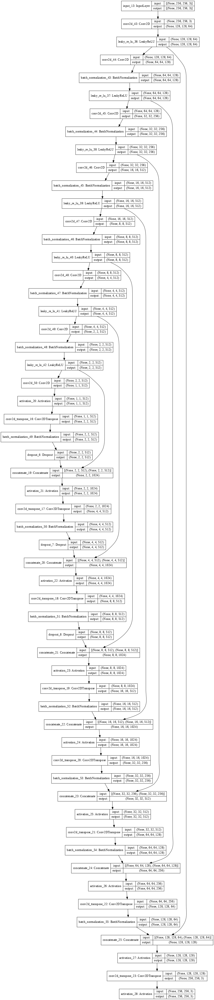

In [106]:
generator = create_generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi = 64)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


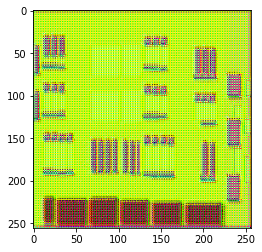

In [45]:
gen_output = generator(input[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

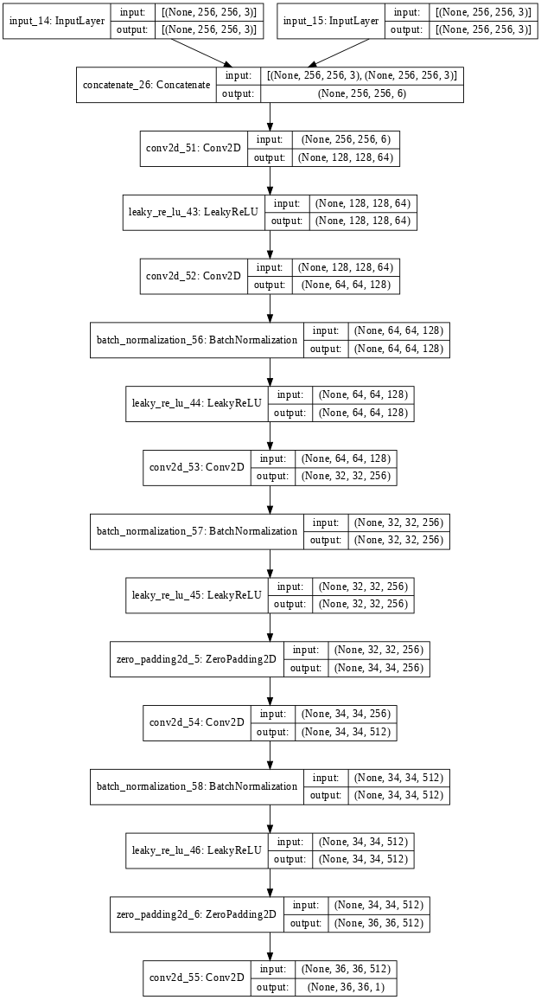

In [107]:
discriminator = create_discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi = 64)

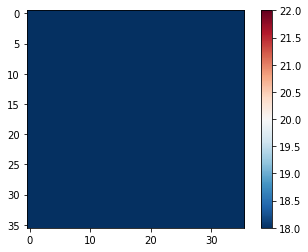

In [62]:
disc_output = discriminator([input[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_output[0, ..., -1], vmin=20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [56]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [69]:
Lambda = 100
def generator_loss(discriminator_output, generator_output, target):
    gan_loss = loss_obj(tf.ones_like(discriminator_output), discriminator_output)

    l1_loss = tf.reduce_mean(tf.abs(target - generator_output))
    total_generator_loss = gan_loss + (Lambda * l1_loss)
    return total_generator_loss, gan_loss, l1_loss

In [58]:
def discriminator_loss(discriminator_real_output, discriminator_generated_output):
    real_loss = loss_obj(tf.ones_like(discriminator_generated_output), discriminator_generated_output)
    generated_loss = loss_obj(tf.zeros_like(discriminator_generated_output), discriminator_generated_output)
    total_discriminator_loss = real_loss + generated_loss
    return total_discriminator_loss

In [63]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [64]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [74]:
def generate_images(generator, test_input, target, epoch):
    prediction = generator(test_input, training=False)
    plt.figure(figsize=(15, 15))
    
    display_list = [test_input[0], target[0], prediction[0]]
    title = ['Input Image', 'Expected', 'Generated']

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')

    plt.savefig("image_at_epoch{:03d}.png".format(epoch))
    plt.show()

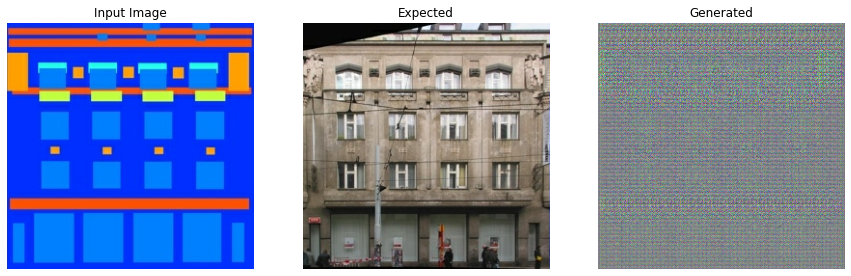

In [66]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

In [103]:
log_dir = './logs/'
summary_write = tf.summary.create_file_writer(log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [109]:
@tf.function
def train_step(input, target, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generator_output = generator(input, training=True) 

        discriminator_real_output = discriminator([input, target], training=True)
        discriminator_generated_output = discriminator([input, generator_output], training=True)

        generator_total_loss, generator_gan_loss, generator_l1_loss = generator_loss(discriminator_generated_output, generator_output, target)
        disc_loss = discriminator_loss(discriminator_real_output, discriminator_generated_output)

    generator_gradients = gen_tape.gradient(generator_total_loss,
                                            generator.trainable_variables)
    
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                 discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    with summary_write.as_default():
        tf.summary.scalar('generator_total_loss', generator_total_loss, step=epoch)
        tf.summary.scalar('generator_gan_loss', generator_gan_loss, step=epoch)
        tf.summary.scalar('generator_l1_loss', generator_l1_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [104]:
sample_input, sample_target = None, None
for ex_input, ex_target in test_dataset.take(1):
    sample_input, sample_target = ex_input, ex_target

def train_gan(train_dataset, epochs, test_dataset):
    for epoch in range(epochs):
        start = time.time()
        print(f"Epoch: {epoch}/{epochs} =>")
        generate_images(generator, sample_input, sample_target, epoch)
        
        for n, (input, target) in enumerate(train_dataset):
            train_step(input, target, epoch)
        print()

        if (epoch + 1) % 20 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print(f"Time taken for epoch {epoch + 1} is {time.time() - start} sec\n")
    checkpoint.save(file_prefix= checkpoint_prefix)

In [105]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir}

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
train_gan(train_dataset, 150, test_dataset)

Output hidden; open in https://colab.research.google.com to view.


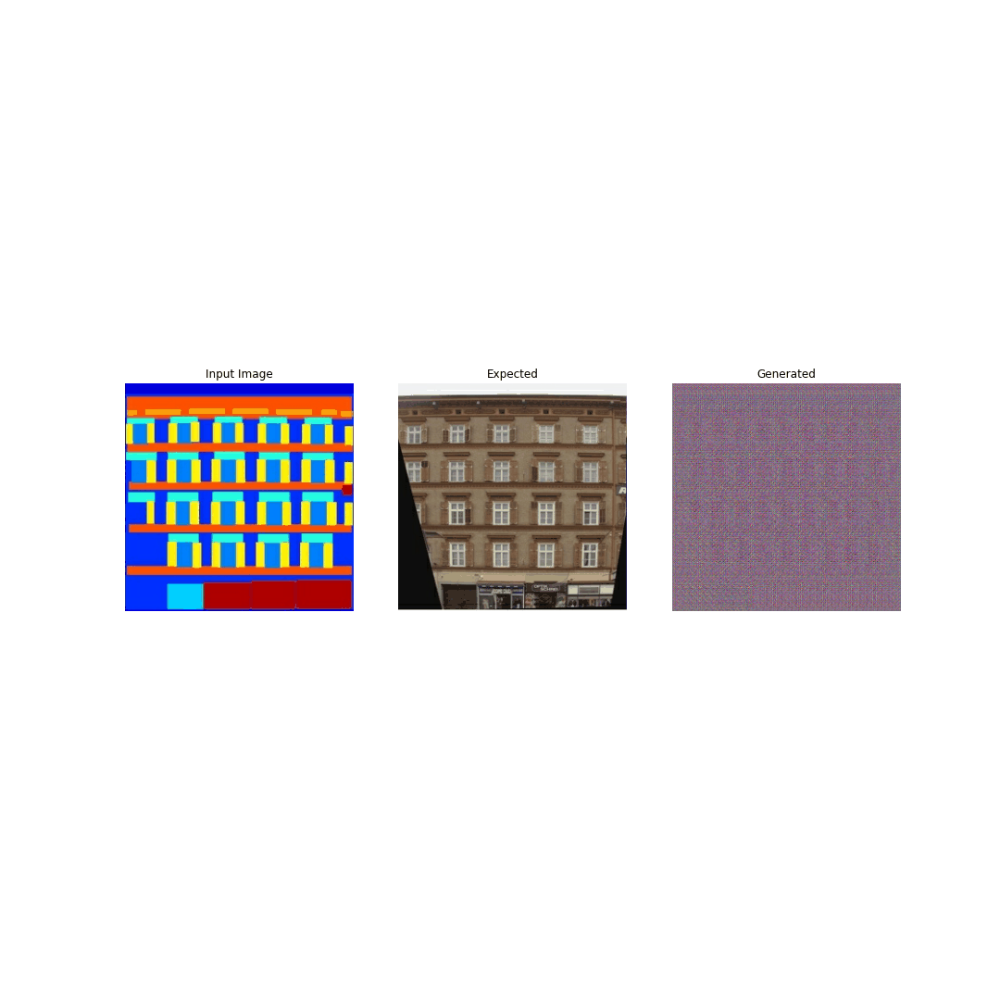

In [6]:
import tensorflow_docs.vis.embed as embed
anim_file = "Pix2PixGAN_l2f.gif"

with imageio.get_writer(anim_file, mode="I") as writer:
    filenames = glob.glob('image_at_epoch*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

embed.embed_file(anim_file)